# SVM и его ядра
__Суммарное количество баллов: 9__

__Решение отправлять на `ml.course.practice@gmail.com`__

__Тема письма: `[ML][HW07] <ФИ>`, где вместо `<ФИ>` указаны фамилия и имя__

В этом задании нам предстоит решить задачу SVM при помощи `cvxopt` и применить ее к искуственным данным. Затем аналогичным способом нужно будет решить задачу ядерного SVM и исследовать его поведение для различных ядер и значений их параметров.

In [2]:
import numpy as np
import copy
from cvxopt import spmatrix, matrix, solvers
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification, make_moons, make_blobs

solvers.options['show_progress'] = False

In [3]:
def visualize(clf, X, y):
    x_min, x_max = X[:, 0].min(), X[:, 0].max()
    y_min, y_max = X[:, 1].min(), X[:, 1].max()
    x_border = (x_max - x_min) / 20 + 1.0e-3
    x_h = (x_max - x_min + 2 * x_border) / 200
    y_border = (y_max - y_min) / 20 + 1.0e-3
    y_h = (y_max - y_min + 2 * y_border) / 200
    
    cm = plt.cm.Spectral

    xx, yy = np.meshgrid(np.arange(x_min - x_border, x_max + x_border, x_h), np.arange(y_min - y_border, y_max + y_border, y_h))
    mesh = np.c_[xx.ravel(), yy.ravel()]

    z_class = clf.predict(mesh).reshape(xx.shape)

    # Put the result into a color plot
    plt.figure(1, figsize=(8, 8))
    plt.pcolormesh(xx, yy, z_class, cmap=cm, alpha=0.3, shading='gouraud')

    # Plot hyperplane and margin
    z_dist = clf.decision_function(mesh).reshape(xx.shape)
    plt.contour(xx, yy, z_dist, [0.0], colors='black')
    plt.contour(xx, yy, z_dist, [-1.0, 1.0], colors='black', linestyles='dashed')

    # Plot also the training points
    y_pred = clf.predict(X)

    ind_support = []
    ind_correct = []
    ind_incorrect = []
    for i in range(len(y)):
        if i in clf.support:
            ind_support.append(i)
        elif y[i] == y_pred[i]:
            ind_correct.append(i)
        else:
            ind_incorrect.append(i)

    plt.scatter(X[ind_correct, 0], X[ind_correct, 1], c=y[ind_correct], cmap=cm, alpha=1., edgecolor='black', linewidth=.8)
    plt.scatter(X[ind_incorrect, 0], X[ind_incorrect, 1], c=y[ind_incorrect], cmap=cm, alpha=1., marker='*',
               s=50, edgecolor='black', linewidth=.8)
    plt.scatter(X[ind_support, 0], X[ind_support, 1], c=y[ind_support], cmap=cm, alpha=1., edgecolor='yellow', linewidths=1.,
               s=40)

    plt.xlim(xx.min(), xx.max())
    plt.ylim(yy.min(), yy.max())
    plt.tight_layout()

In [4]:
def generate_dataset(moons=False):
    if moons:
        X, y = make_moons(1000, noise=0.075, random_state=42)
        return X, 2 * y - 1
    X, y = make_blobs(1000, 2, centers=[[0, 0], [-4, 2], [3.5, -2.0], [3.5, 3.5]], random_state=42)
    y = 2 * (y % 2) - 1
    return X, y
    #return make_classification(1000, 2, 2, 0, flip_y=0.001, class_sep=1.2, scale=0.9, random_state=42)

X, y = generate_dataset(True)

### Задание 1 (2 балла)
Для начала реализуем обычный линейный SVM. 

#### Методы
`fit(X, y)` - обучает SVM, решая задачу оптимизации при помощи `cvxopt.solvers.qp`

`decision_function(X)` - возвращает значение решающей функции (т.е. то число, от которого берем знак с целью узнать класс)

#### Поля
`support` - индексы опорных элементов

In [7]:
class LinearSVM:
    def __init__(self, C):
        self.C = C
        self.support = None
        self.w = None
        self.w0 = None

    def fit(self, X, y):
        P = matrix((y.reshape(-1, 1) * X).dot((y.reshape(-1, 1) * X).T))
        q = matrix(-np.ones(X.shape[0]))
        G = matrix(np.concatenate((-np.eye(X.shape[0]), np.eye(X.shape[0])), axis=0))
        h = matrix(np.concatenate((np.zeros(X.shape[0]), self.C * np.ones(X.shape[0])), axis=0))
        A = matrix((y * 1.0).reshape(1, -1))
        b = matrix(np.zeros(1))
        all_alphas = np.array(solvers.qp(P, q, G, h, A, b)['x'])
        self.support = np.array([i for i in range(len(all_alphas)) if all_alphas[i] > 0.0001])
        alphas = all_alphas[self.support]
        support_vectors = X[self.support]
        support_labels = y.reshape(-1, 1)[self.support]
        self.w = np.sum(alphas * support_labels * support_vectors, axis=0)
        goods = [i for i in range(len(self.support)) if alphas[i] < self.C - 0.0001]
        self.w0 = np.average(self.w.dot(support_vectors[goods].T)) - np.average(support_labels[goods])

    def decision_function(self, X):
        return self.w.dot(X.T) - self.w0

    def predict(self, X):
        return np.sign(self.decision_function(X))

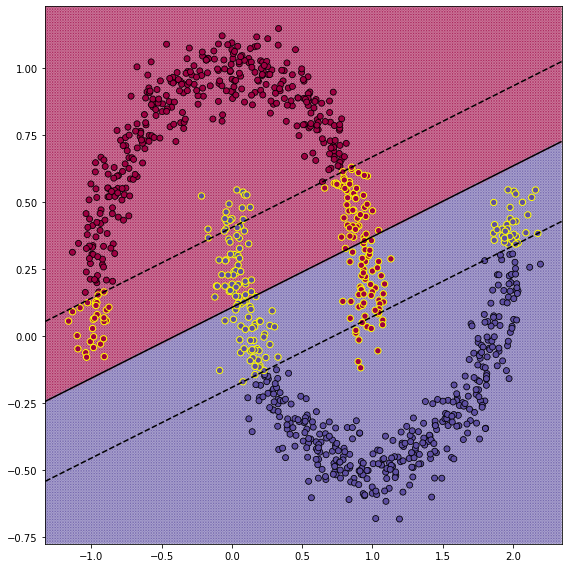

In [28]:
X, y = generate_dataset(True)
svm = LinearSVM(1)
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

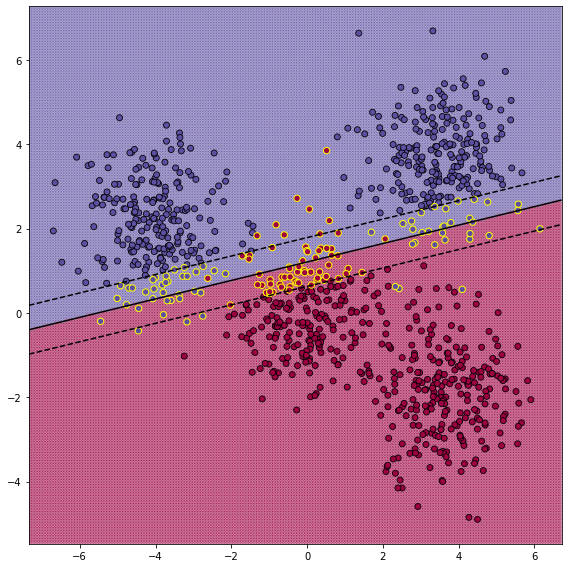

In [29]:
X, y = generate_dataset(False)
svm = LinearSVM(1)
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

### Задание 2 (2 балла)
Перед реализацией ядерного SVM, реализуем функции, которые строят ядра.

#### Описание
`get_polynomial_kernel(power)` - возвращает полиномиальное ядро с заданной константой и степенью

`get_gaussian_kernel(sigma=1.)` - возвращает ядро Гаусса с заданным коэффицинтом сигма

In [9]:
def get_polynomial_kernel(c=1, power=2):
    return lambda x, y: (c + np.dot(x, y)) ** power


def get_gaussian_kernel(sigma=1.):
    return lambda x, y: np.exp(-np.dot(x - y, x - y) / 2 / sigma ** 2)

def linear_kernel(x, y):
    return np.dot(x, y)

### Задание 3 (2 балла)
Теперь перейдем к реализации самого kernel SVM.

#### Описание
`fit(X, y)` - обучает kernel SVM, решая задачу оптимизации при помощи `cvxopt.solvers.qp`

`decision_function(X)` - возвращает значение решающей функции (т.е. то число, от которого берем знак с целью узнать класс)

#### Конструктор
`kernel` - ядро-функция

In [10]:
class KernelSVM:
    def __init__(self, C, kernel=linear_kernel):
        self.C = C
        self.kernel = kernel
        self.support = None
        self.support_labels = None
        self.support_vectors = None
        self.alphas = None
        self.w0 = None

    def wtx(self, z):
        return np.sum([a * y * self.kernel(x, z) for a, y, x in zip(self.alphas, self.support_labels, self.support_vectors)])

    def fit(self, X, y):
        P = matrix(np.array([[y1 * y2 * self.kernel(x1, x2) for x1, y1 in zip(X, y)] for x2, y2 in zip(X, y)]))
        q = matrix(-np.ones(X.shape[0]))
        G = matrix(np.concatenate((-np.eye(X.shape[0]), np.eye(X.shape[0])), axis=0))
        h = matrix(np.concatenate((np.zeros(X.shape[0]), self.C * np.ones(X.shape[0])), axis=0))
        A = matrix((y + 0.0).reshape(1, -1))
        b = matrix(np.zeros(1))
        
        all_alphas = np.array(solvers.qp(P, q, G, h, A, b)['x'])
        self.support = np.array([i for i in range(len(all_alphas)) if all_alphas[i] > 0.0001])
        self.alphas = all_alphas[self.support]
        self.support_vectors = X[self.support]
        self.support_labels = y.reshape(-1, 1)[self.support]
        self.w0 = np.average([self.wtx(x) for x in self.support_vectors]) - np.average(self.support_labels)

    def decision_function(self, X):
        return np.array([self.wtx(x) for x in X]) - self.w0

    def predict(self, X):
        return np.sign(self.decision_function(X))


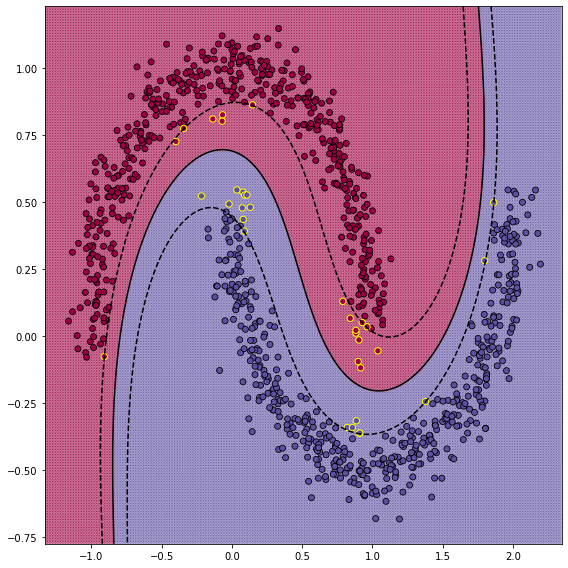

In [61]:
X, y = generate_dataset(True)
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 3))
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

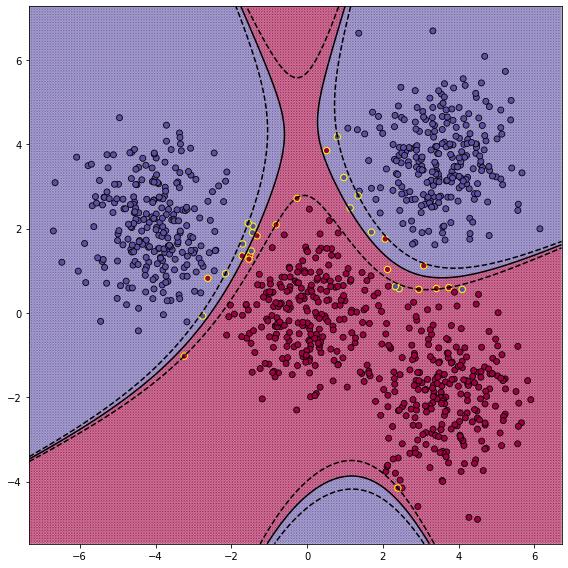

In [54]:
X, y = generate_dataset(False)
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 3))
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

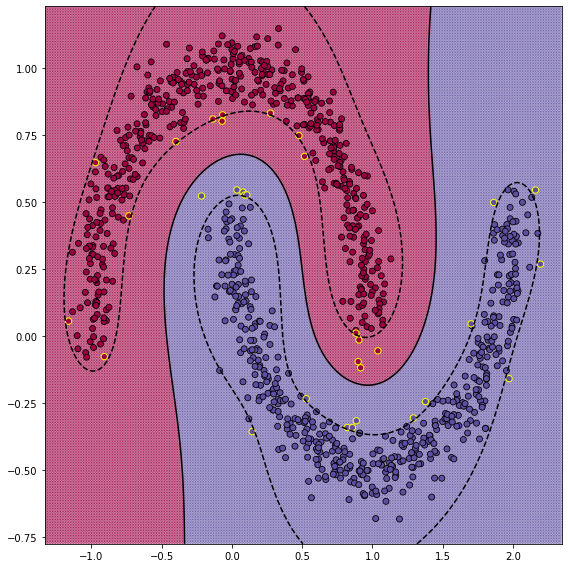

In [55]:
X, y = generate_dataset(True)
svm = KernelSVM(1, kernel=get_gaussian_kernel(0.4))
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

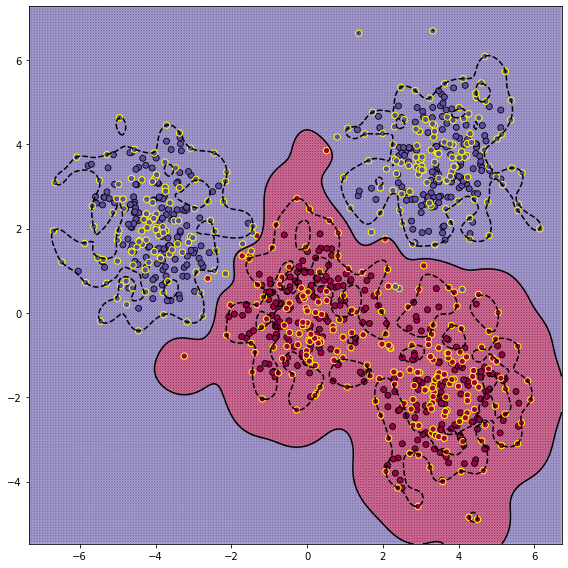

In [56]:
X, y = generate_dataset(False)
svm = KernelSVM(1, kernel=get_gaussian_kernel(0.4))
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

### Задание 4 (3 балла)
Исследуйте и опишите влияние параметров каждого вида ядра на полученный классификатор. Что происходит при увеличении константы в полиномиальном ядре? При увеличении степени? Как влияет на результат сигма в ядре Гаусса?

__При выполнении этого задания стоит написать код, который визуализирует классификаторы с различными ядрами__

c = 0


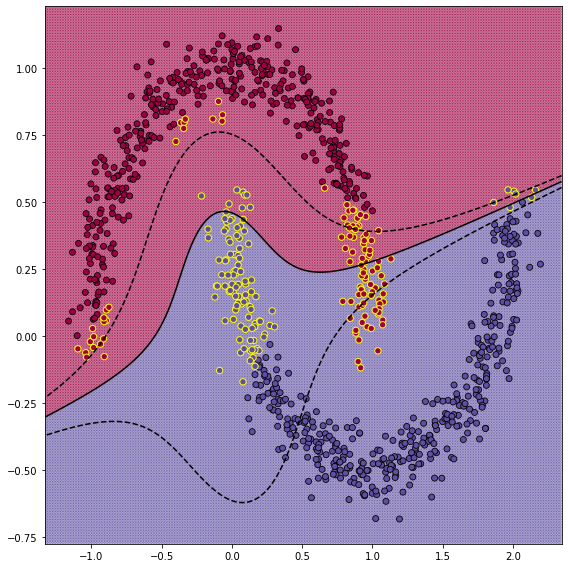

c = 0.01


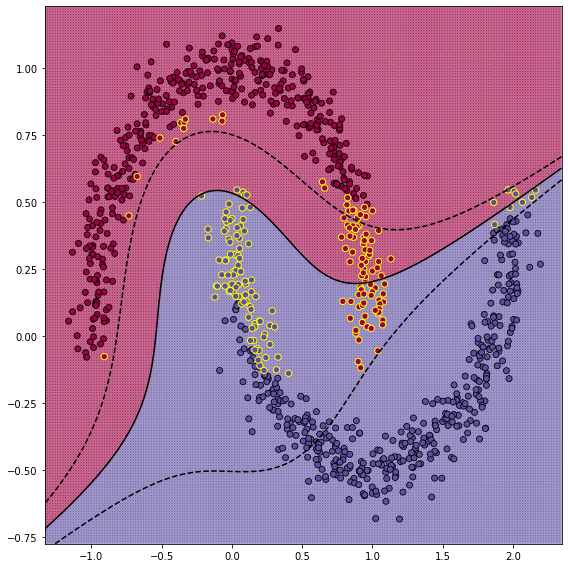

c = 0.05


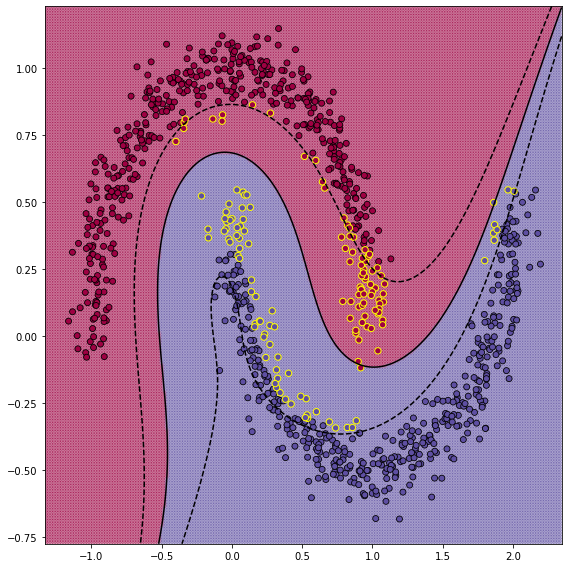

c = 0.1


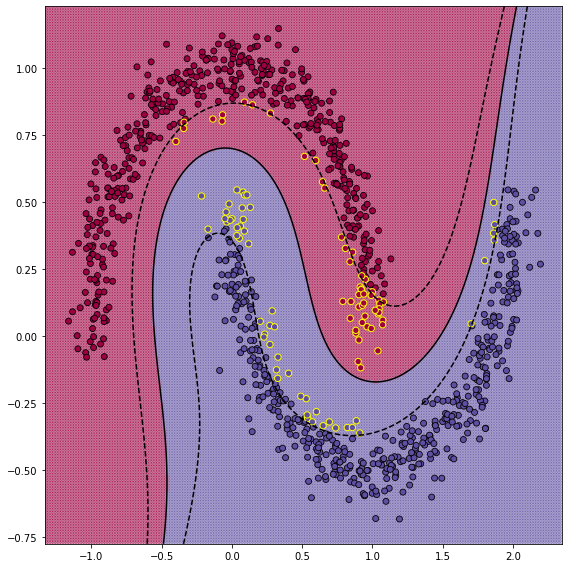

c = 0.2


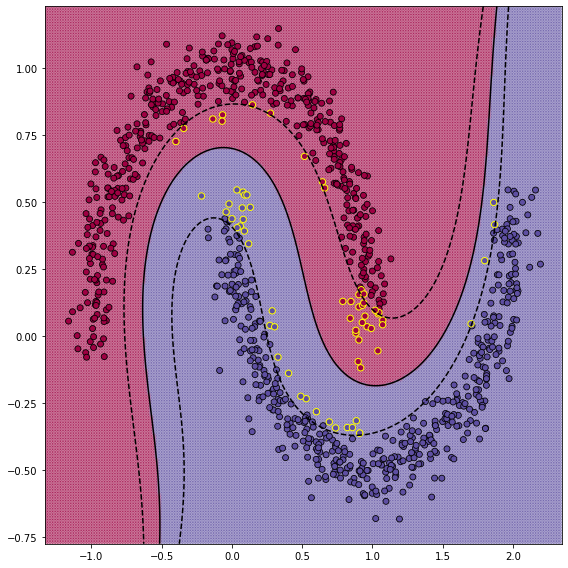

c = 0.3


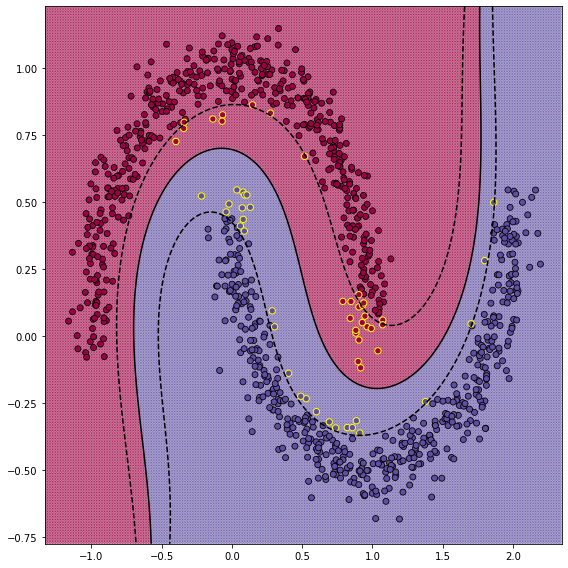

c = 0.5


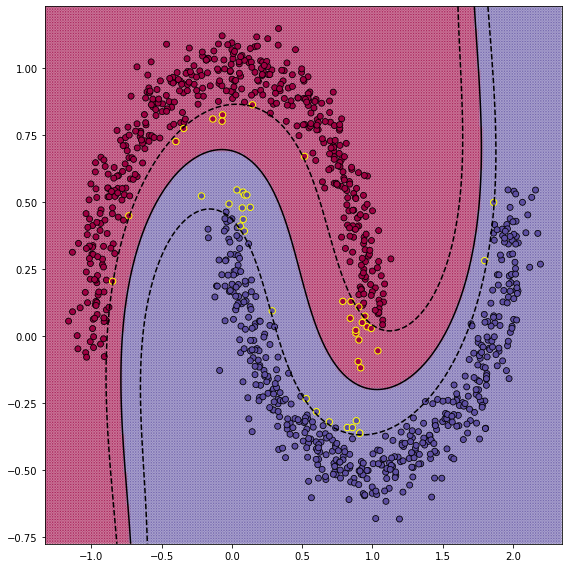

c = 1


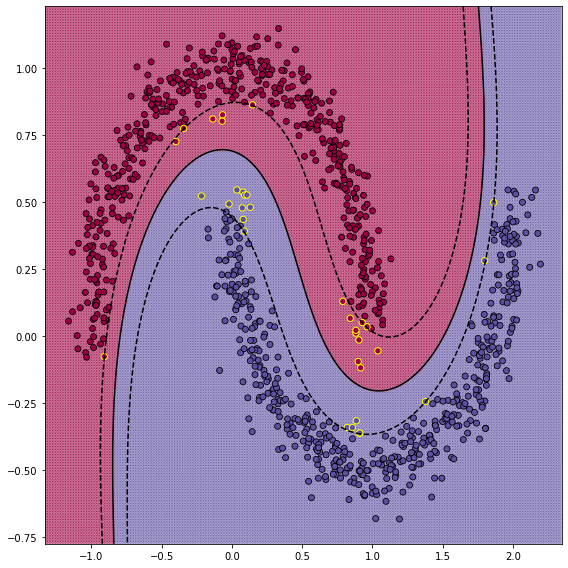

c = 0


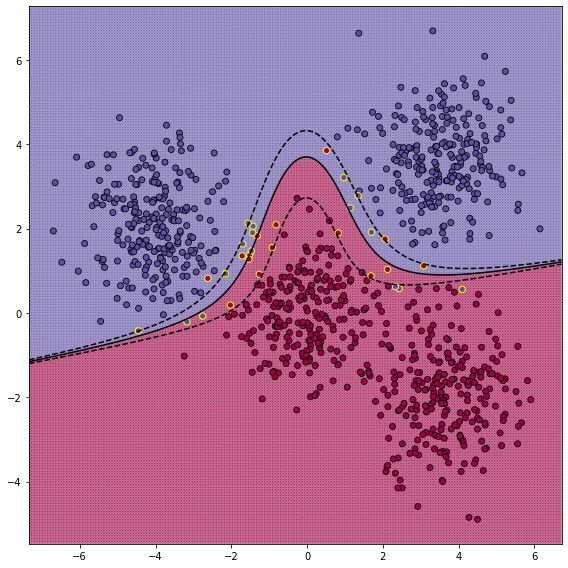

c = 0.01


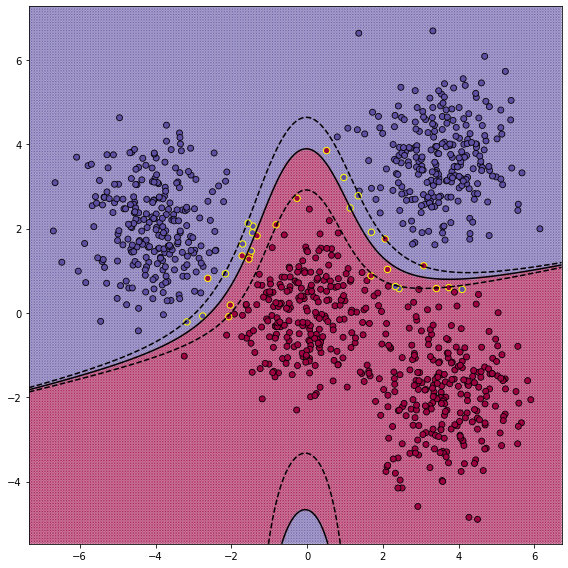

c = 0.05


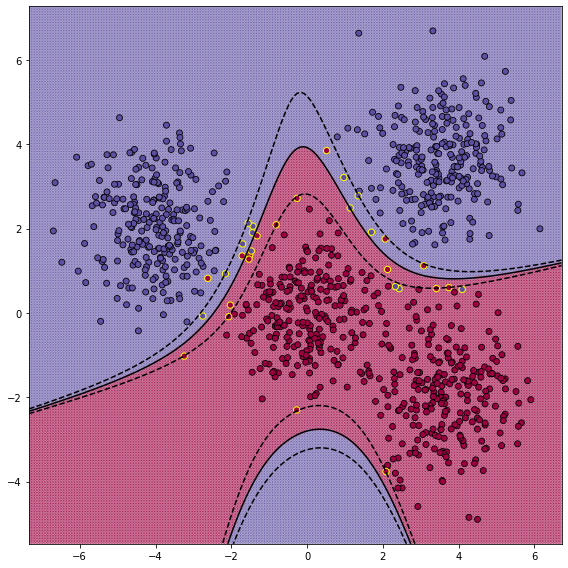

c = 0.1


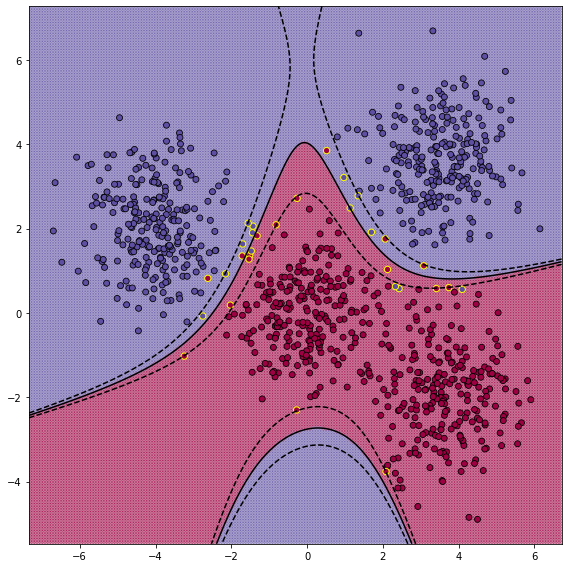

c = 0.2


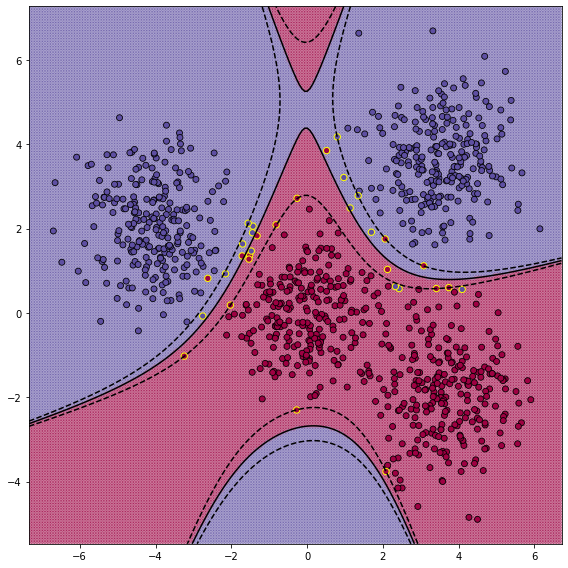

c = 0.3


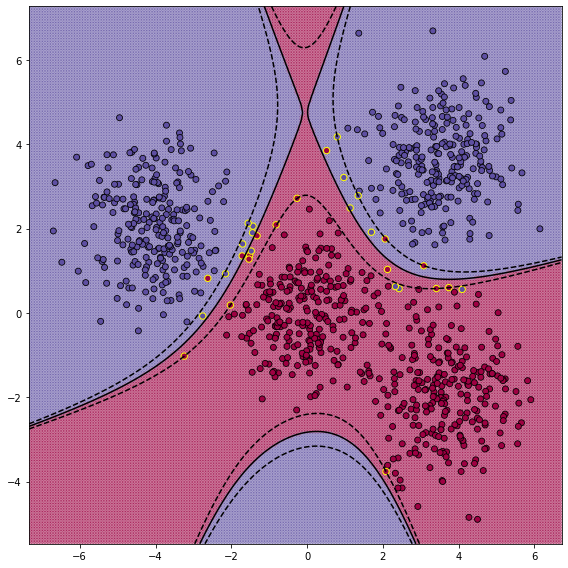

c = 0.5


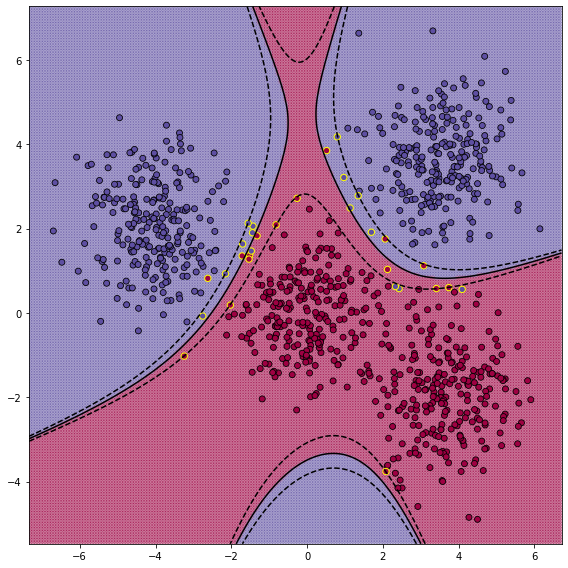

c = 1


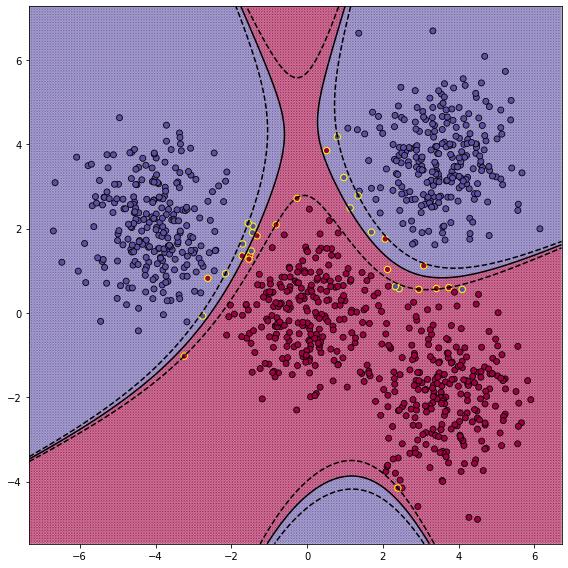

In [12]:
#увеличение константы:
#при c>1 картинка практически не меняется

X, y = generate_dataset(True)

for c in [0, 0.01, 0.05, 0.1, 0.2, 0.3, 0.5, 1]:
    svm = KernelSVM(1, kernel=get_polynomial_kernel(c, 3))
    svm.fit(X, y)
    print('c =', c)
    visualize(svm, X, y)
    plt.show()

X, y = generate_dataset(False)

for c in [0, 0.01, 0.05, 0.1, 0.2, 0.3, 0.5, 1]:
    svm = KernelSVM(1, kernel=get_polynomial_kernel(c, 3))
    svm.fit(X, y)
    print('c =', c)
    visualize(svm, X, y)
    plt.show()

d = 1


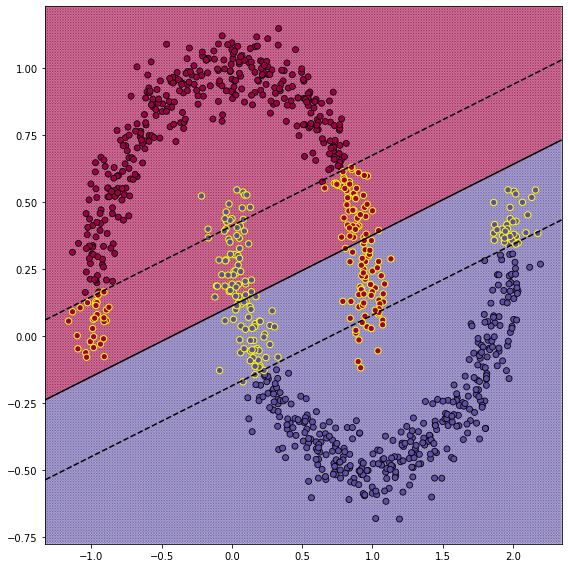

d = 2


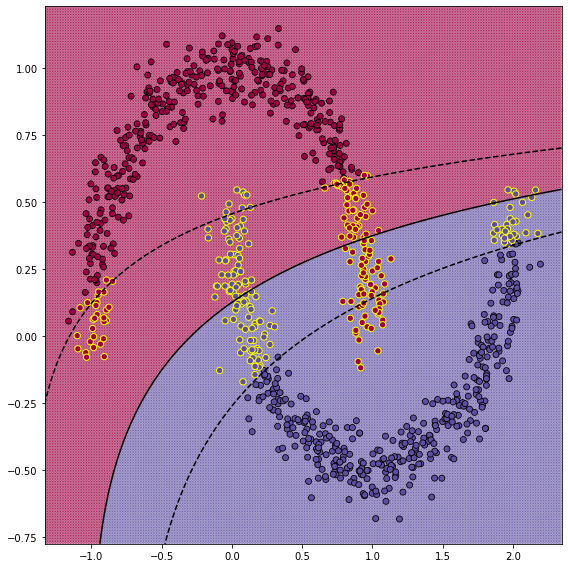

d = 3


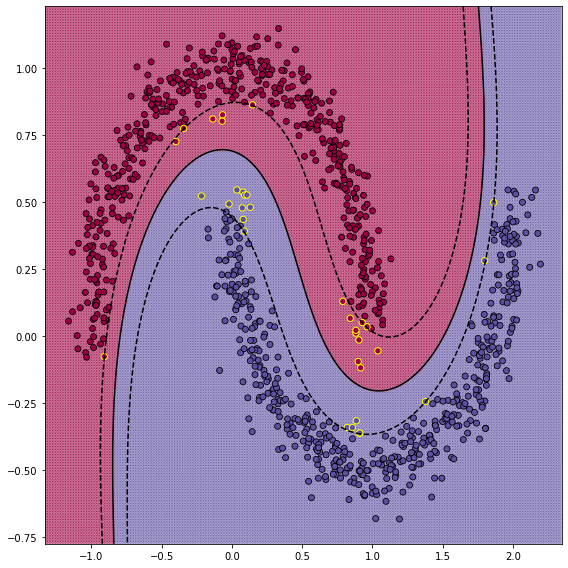

d = 4


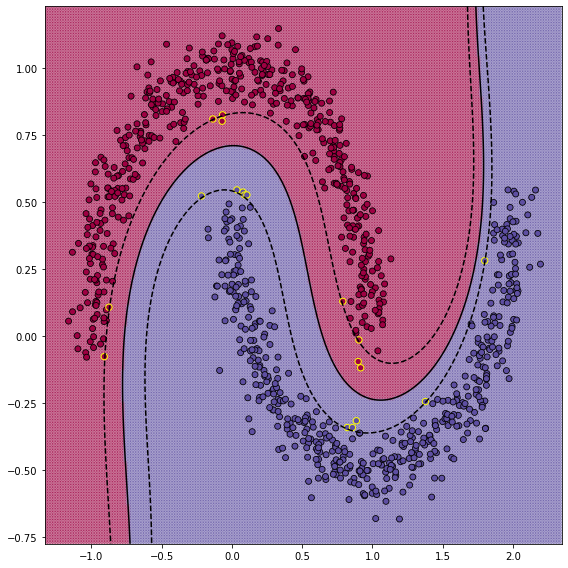

d = 5


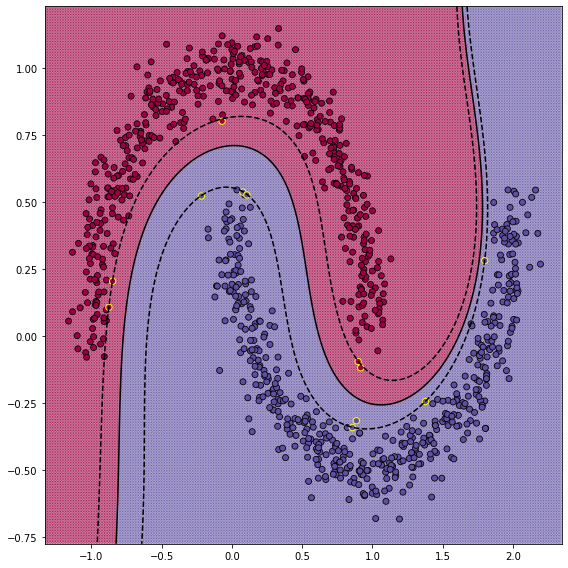

d = 1


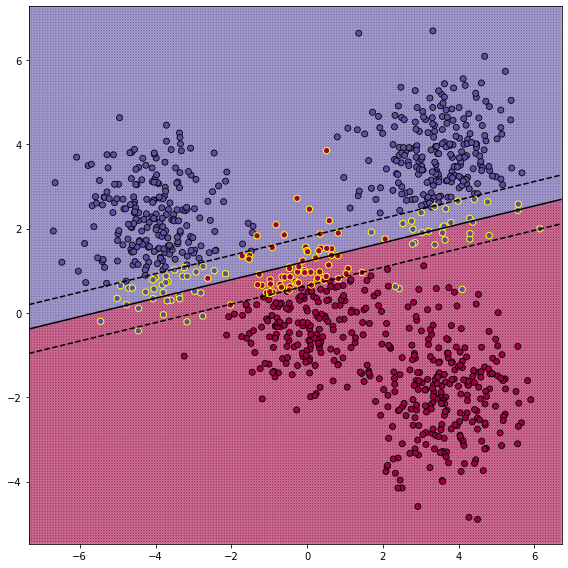

d = 2


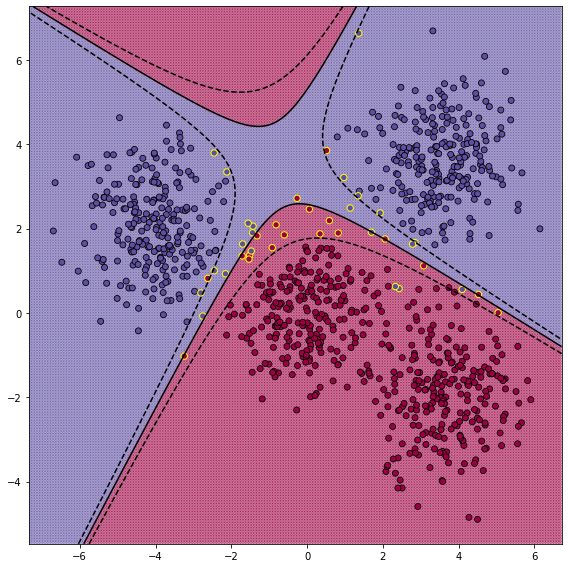

d = 3


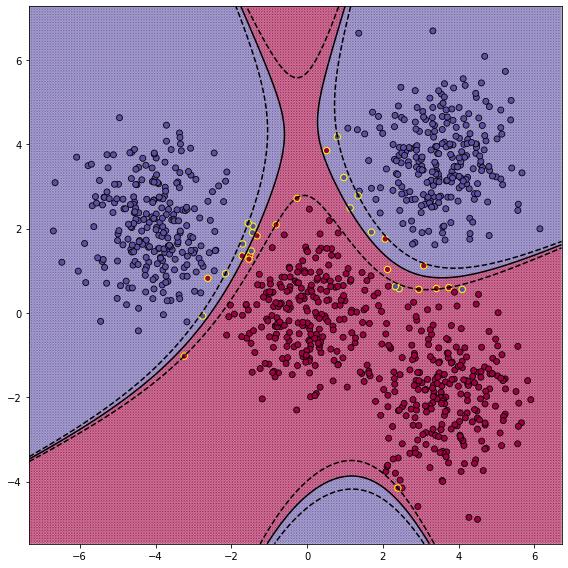

d = 4


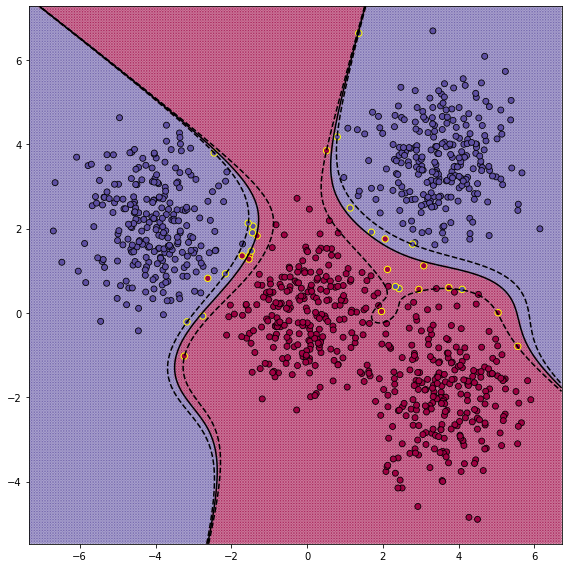

d = 5


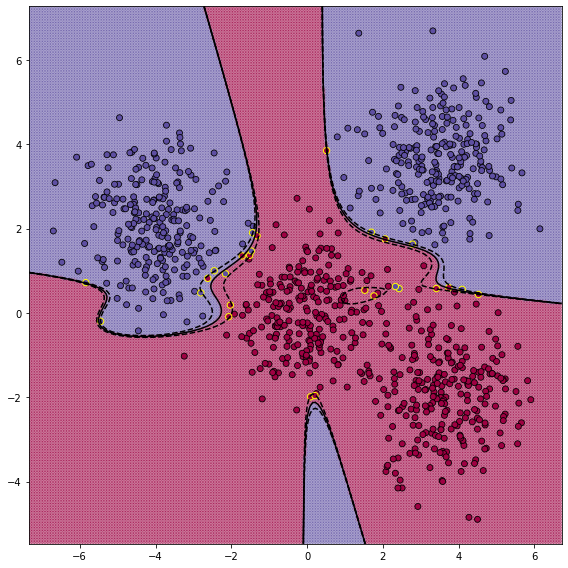

In [14]:
#увеличение степени:

X, y = generate_dataset(True)

for d in [1, 2, 3, 4, 5]:
    svm = KernelSVM(1, kernel=get_polynomial_kernel(1, d))
    svm.fit(X, y)
    print('d =', d)
    visualize(svm, X, y)
    plt.show()

X, y = generate_dataset(False)

for d in [1, 2, 3, 4, 5]:
    svm = KernelSVM(1, kernel=get_polynomial_kernel(1, d))
    svm.fit(X, y)
    print('d =', d)
    visualize(svm, X, y)
    plt.show()

s = 0.01


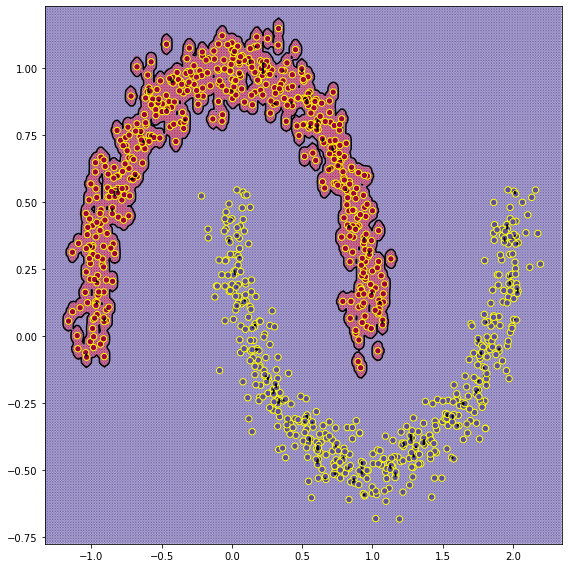

s = 0.1


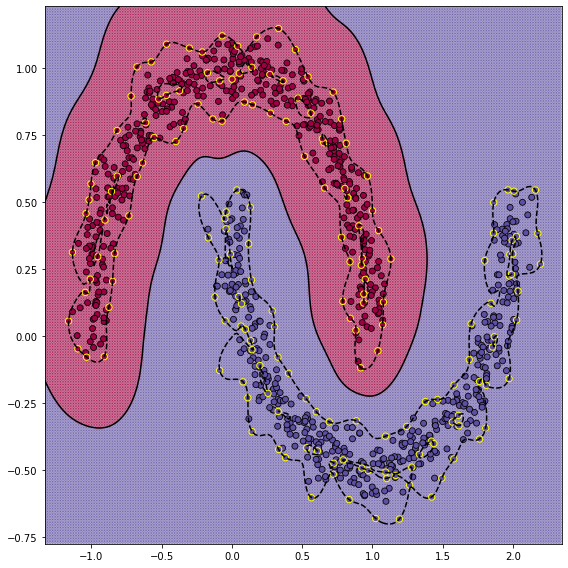

s = 0.5


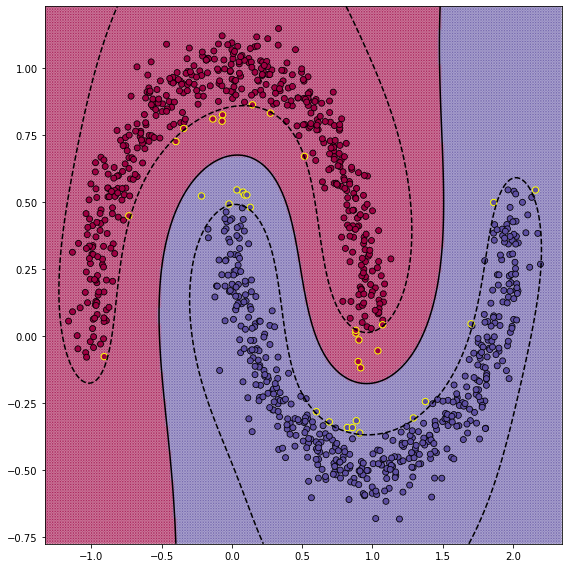

s = 1


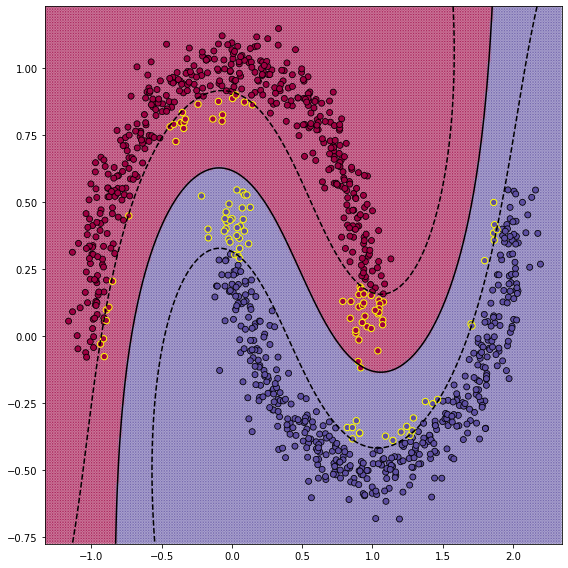

s = 5


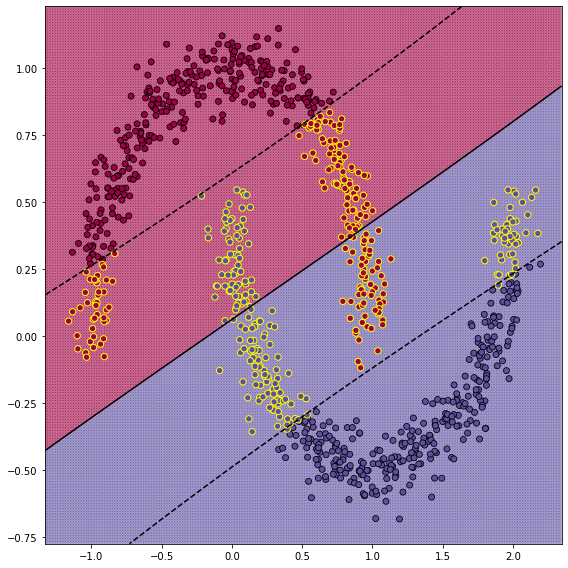

s = 10


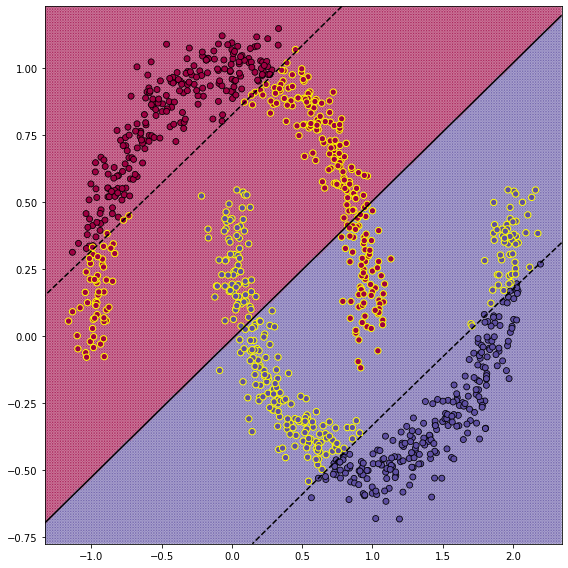

s = 0.01


C:\Users\Nikita\Anaconda3\lib\site-packages\ipykernel_launcher.py:23: UserWarning: No contour levels were found within the data range.


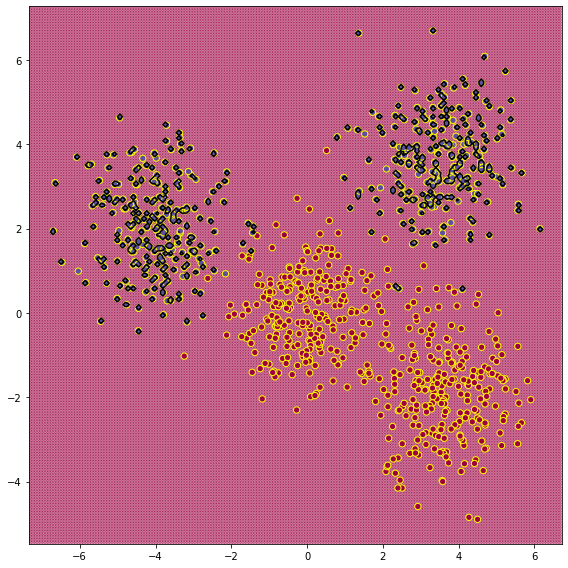

s = 0.1


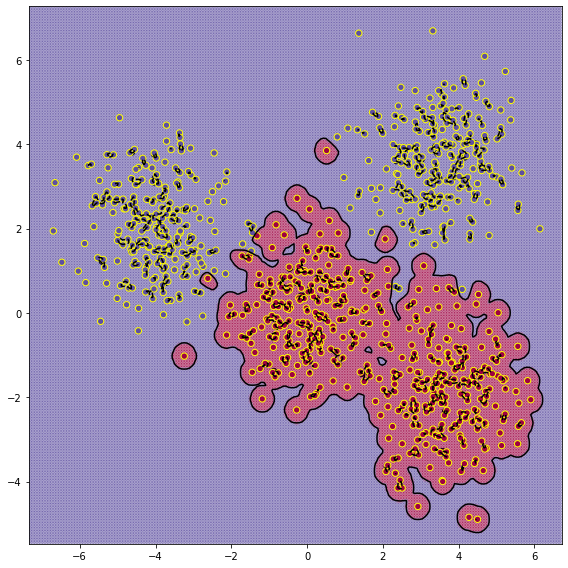

s = 0.5


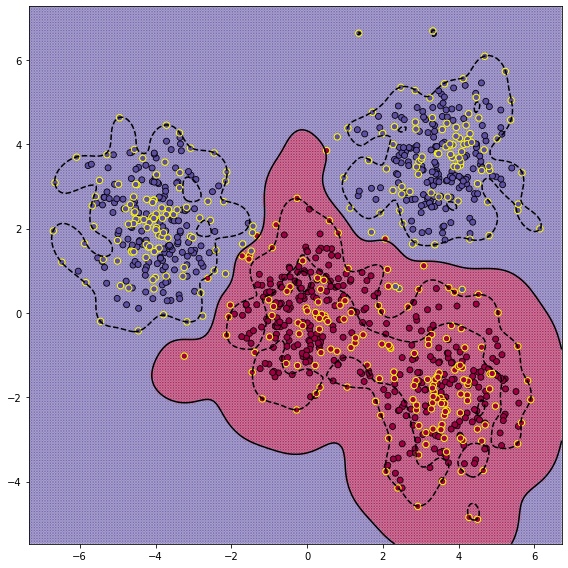

s = 1


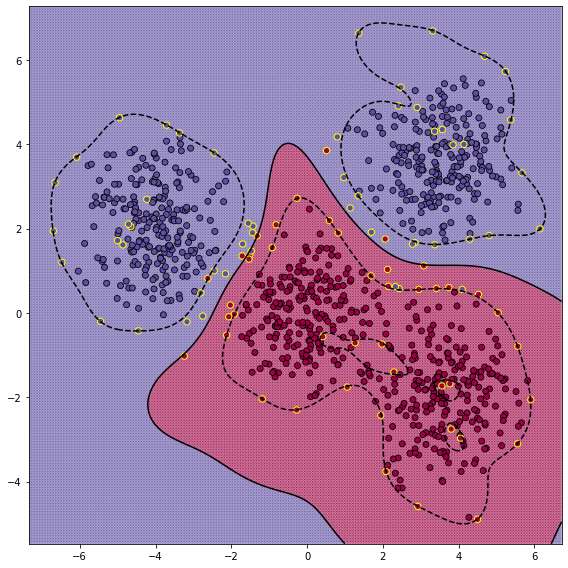

s = 5


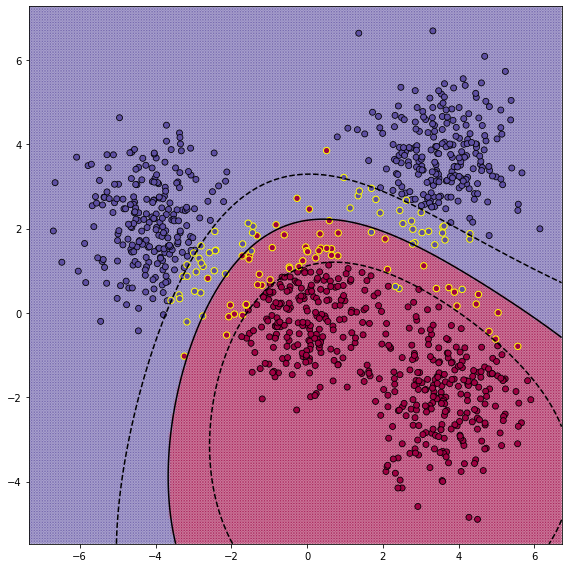

s = 10


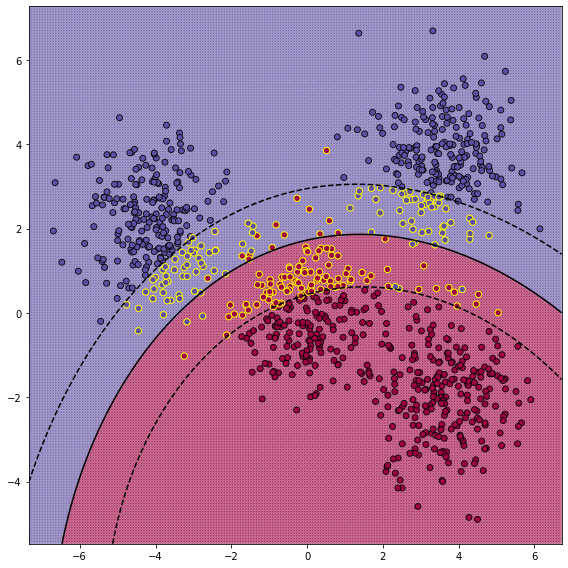

In [15]:
#изменение сигмы:

X, y = generate_dataset(True)

for s in [0.01, 0.1, 0.5, 1, 5, 10]:
    svm = KernelSVM(1, kernel=get_gaussian_kernel(s))
    svm.fit(X, y)
    print('s =', s)
    visualize(svm, X, y)
    plt.show()

X, y = generate_dataset(False)

for s in [0.01, 0.1, 0.5, 1, 5, 10]:
    svm = KernelSVM(1, kernel=get_gaussian_kernel(s))
    svm.fit(X, y)
    print('s =', s)
    visualize(svm, X, y)
    plt.show()


Увеличение константы мало влияет на результат. При увеличении степени в полиномиальном ядре или увеличение сигмы в Гауссовском модель становится более выразительной и более склонна к переобучению.